In [1]:
from core.utils import register_metadrive
register_metadrive()

/Users/tanmay/opt/anaconda3/envs/cs269/lib/python3.7/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Successfully registered the following environments: ['MetaDrive-validation-v0', 'MetaDrive-10env-v0', 'MetaDrive-100envs-v0', 'MetaDrive-1000envs-v0', 'SafeMetaDrive-validation-v0', 'SafeMetaDrive-10env-v0', 'SafeMetaDrive-100envs-v0', 'SafeMetaDrive-1000envs-v0', 'MARLTollgate-v0', 'MARLBottleneck-v0', 'MARLRoundabout-v0', 'MARLIntersection-v0', 'MARLParkingLot-v0', 'MARLMetaDrive-v0'].
Successfully registered MetaDrive environments:  ['MetaDrive-Tut-Easy-v0', 'MetaDrive-Tut-Hard-v0', 'MetaDrive-Gen-v0', 'MetaDrive-Gen-v1', 'MetaDrive-Gen-v2', 'MetaDrive-Gen-v3', 'MetaDrive-Gen-Next-v0', 'MetaDrive-Gen-Next-v1', 'MetaDrive-Gen-Next-v2', 'MetaDrive-Alt-Next-v0', 'MetaDrive-Alt-Next-v1', 'MetaDrive-Alt-Next-v2', 'MetaDrive-MARL-v0', 'MetaDrive-MARL-v1', 'MetaDrive-MARL-v2', 'MetaDrive-MARL-v3']


In [2]:
import gym
# env=gym.make("MetaDrive-Tut-Test-v0")

In [3]:
# env.get_single_observation(env.config["vehicle_config"]).state_obs.observation_space
# print(env.config["vehicle_config"])

In [4]:
# env2=gym.make("MetaDrive-MARL-v0")

In [5]:
# env2.get_single_observation(env.config["vehicle_config"]).state_obs.observation_space
# print(env2.config["vehicle_config"]["lidar"])

/Users/tanmay/Desktop/Fall 2022/RL/assignment-2022fall/assignment3-project/core
/Users/tanmay/Desktop/Fall 2022/RL/assignment-2022fall/assignment3-project/core
Cannot re-register id: MetaDrive-Tut-Easy-v0
{'increment_steering': False, 'vehicle_model': 'static_default', 'show_navi_mark': True, 'extra_action_dim': 0, 'enable_reverse': False, 'random_navi_mark_color': False, 'show_dest_mark': False, 'show_line_to_dest': False, 'use_special_color': False, 'image_source': 'rgb_camera', 'navigation_module': None, 'need_navigation': True, 'spawn_lane_index': ('>', '>>', 0), 'spawn_longitude': 5.0, 'spawn_lateral': 0.0, 'destination': None, 'overtake_stat': False, 'action_check': False, 'random_color': True, 'random_agent_model': False, 'lidar': {'num_lasers': 240, 'distance': 50, 'num_others': 0, 'gaussian_noise': 0.0, 'dropout_prob': 0.0, 'add_others_navi': False}, 'side_detector': {'num_lasers': 0, 'distance': 50, 'gaussian_noise': 0.0, 'dropout_prob': 0.0}, 'lane_line_detector': {'num_lase

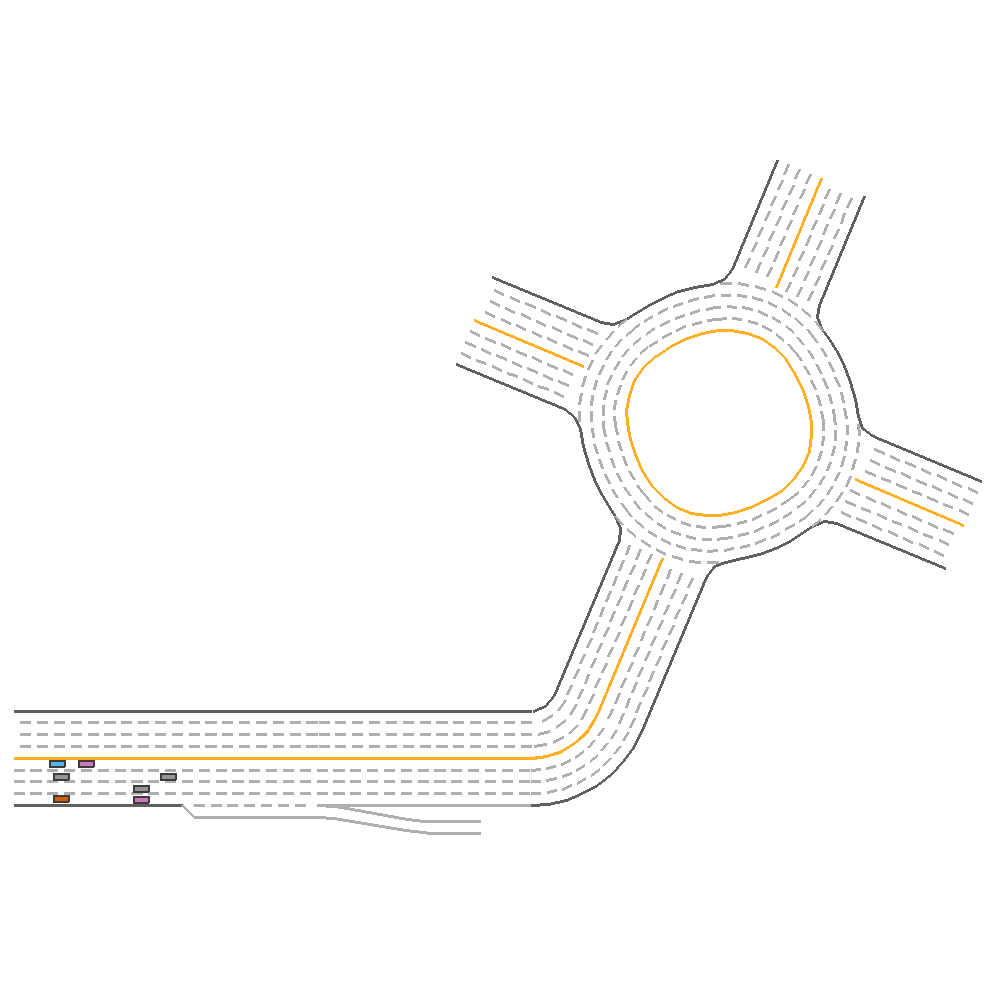

TD3 agent achieves 580.7117342753331 return in MetaDrive Hard environment.


In [6]:
from core.envs import make_envs
import gym
from vis import TD3MARLPolicy, evaluate_MARL, animate
import pygame
import random
import numpy as np

env_name = "MetaDrive-MARL-v0"
policy = TD3MARLPolicy(
    env_name,  # In order to get the observation shape
    num_envs=1, 
    log_dir="MetaDrive-test-rand-v1/td3/",
    suffix="final"
)

random.seed(1)
np.random.seed(1)
map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
env = gym.make(env_name, config={"environment_num":1, "start_seed":70,"map_config":map_config})
env.seed(0)
env._reset_global_seed(0)
print(env.config.vehicle_config)

# Render the learned behavior
# NOTE: The learned agent is marked by green color.
eval_reward, eval_info = evaluate_MARL(
    policy=policy, 
    num_episodes=1, 
    existing_env=env,
    render="topdown",  # Visualize the behaviors in top-down view
    verbose=True
)

frames = [pygame.surfarray.array3d(f).swapaxes(0, 1) for f in eval_info["frames"]]
import tempfile

import IPython
import PIL
import gym
import numpy as np
from IPython.display import clear_output

def animate(img_array):
    """A function that can generate GIF file and show in Notebook."""
    path = tempfile.mkstemp(suffix=".gif")[1]
    images = [PIL.Image.fromarray(frame) for frame in img_array]
    images[0].save(
        path,
        save_all=True,
        append_images=images[1:],
        duration=0.5,
        loop=0
    )
    with open(path, "rb") as f:
        IPython.display.display(
            IPython.display.Image(data=f.read(), format='png'))

animate(frames)

print("TD3 agent achieves {} return in MetaDrive Hard environment.".format(eval_reward))

In [7]:
path = "./marl_with_gen_policy.gif"
images = [PIL.Image.fromarray(frame) for frame in frames]
images[0].save(
    path,
    save_all=True,
    append_images=images[1:],
    duration=20.0,
    loop=0
)

Cannot re-register id: MetaDrive-Tut-Easy-v0
{'increment_steering': False, 'vehicle_model': 'static_default', 'show_navi_mark': True, 'extra_action_dim': 0, 'enable_reverse': False, 'random_navi_mark_color': False, 'show_dest_mark': False, 'show_line_to_dest': False, 'use_special_color': False, 'image_source': 'rgb_camera', 'navigation_module': None, 'need_navigation': True, 'spawn_lane_index': ('>', '>>', 0), 'spawn_longitude': 5.0, 'spawn_lateral': 0.0, 'destination': None, 'overtake_stat': False, 'action_check': False, 'random_color': True, 'random_agent_model': False, 'lidar': {'num_lasers': 240, 'distance': 50, 'num_others': 0, 'gaussian_noise': 0.0, 'dropout_prob': 0.0, 'add_others_navi': False}, 'side_detector': {'num_lasers': 0, 'distance': 50, 'gaussian_noise': 0.0, 'dropout_prob': 0.0}, 'lane_line_detector': {'num_lasers': 0, 'distance': 20, 'gaussian_noise': 0.0, 'dropout_prob': 0.0}, 'show_lidar': False, 'mini_map': (84, 84, 250), 'rgb_camera': (84, 84), 'depth_camera': (84

:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 0.560
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: -6.866
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: -12.737
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: -18.881
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: -32.248
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: -39.126
Evaluating 1/1 episodes. Episode is done in 305 steps. Episode reward: -53.695


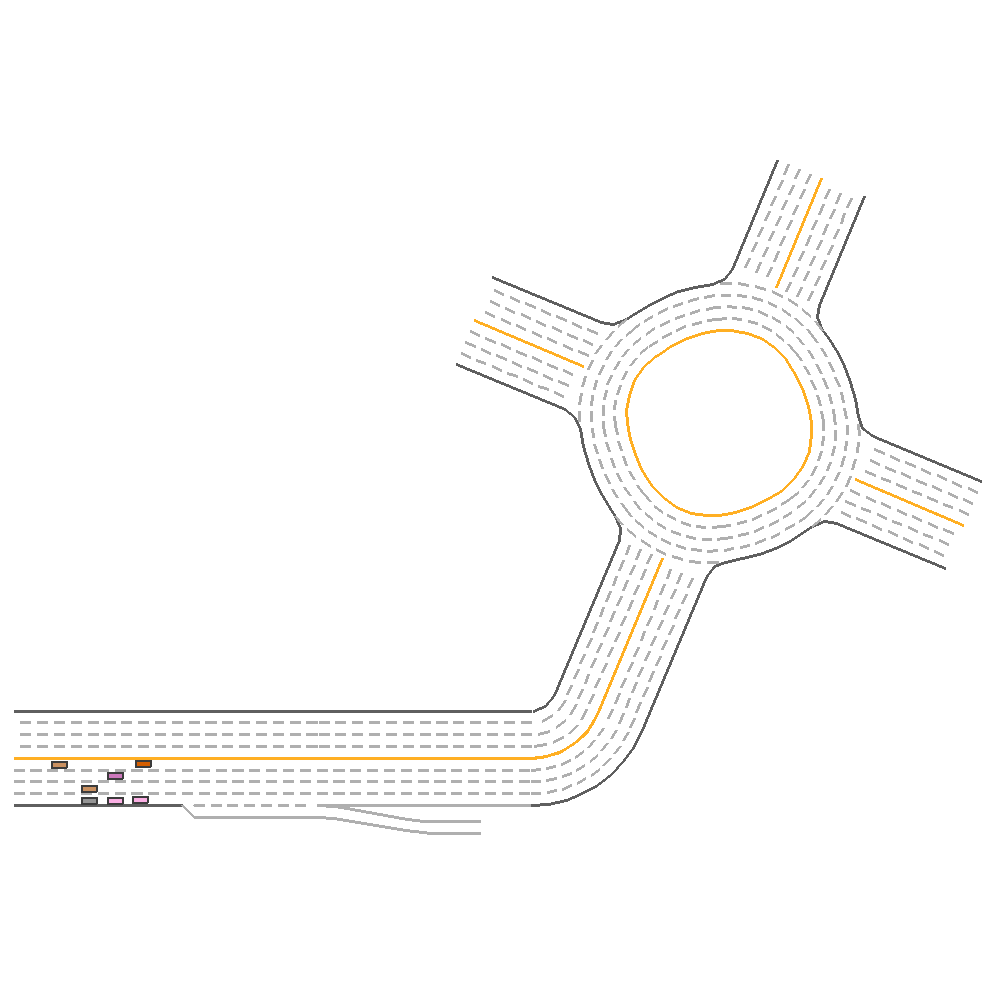

TD3 agent achieves -53.695368847942134 return in MetaDrive Hard environment.


In [8]:
from core.envs import make_envs
import gym
from vis import TD3MARLPolicy, evaluate_MARL, animate
import pygame
import random
import numpy as np

env_name = "MetaDrive-MARL-v0"
policy = TD3MARLPolicy(
    env_name,  # In order to get the observation shape
    num_envs=1, 
    log_dir="MetaDrive-td3combine-expt3/MetaDrive-Gen-v3/td3",
    suffix="final"
)

random.seed(1)
np.random.seed(1)
map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
env = gym.make(env_name, config={"environment_num":1, "start_seed":70,"map_config":map_config})
env.seed(0)
env._reset_global_seed(0)
print(env.config.vehicle_config)

# Render the learned behavior
# NOTE: The learned agent is marked by green color.
eval_reward, eval_info = evaluate_MARL(
    policy=policy, 
    num_episodes=1, 
    existing_env=env,
    render="topdown",  # Visualize the behaviors in top-down view
    verbose=True
)

frames = [pygame.surfarray.array3d(f).swapaxes(0, 1) for f in eval_info["frames"]]
import tempfile

import IPython
import PIL
import gym
import numpy as np
from IPython.display import clear_output

def animate(img_array):
    """A function that can generate GIF file and show in Notebook."""
    path = tempfile.mkstemp(suffix=".gif")[1]
    images = [PIL.Image.fromarray(frame) for frame in img_array]
    images[0].save(
        path,
        save_all=True,
        append_images=images[1:],
        duration=0.5,
        loop=0
    )
    with open(path, "rb") as f:
        IPython.display.display(
            IPython.display.Image(data=f.read(), format='png'))

animate(frames)

print("TD3 agent achieves {} return in MetaDrive Hard environment.".format(eval_reward))

In [9]:
path = "./marl_with_one_type_combine.gif"
images = [PIL.Image.fromarray(frame) for frame in frames]
images[0].save(
    path,
    save_all=True,
    append_images=images[1:],
    duration=20.0,
    loop=0
)

:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


{'increment_steering': False, 'vehicle_model': 'static_default', 'show_navi_mark': True, 'extra_action_dim': 0, 'enable_reverse': False, 'random_navi_mark_color': False, 'show_dest_mark': False, 'show_line_to_dest': False, 'use_special_color': False, 'image_source': 'rgb_camera', 'navigation_module': None, 'need_navigation': True, 'spawn_lane_index': ('>', '>>', 0), 'spawn_longitude': 5.0, 'spawn_lateral': 0.0, 'destination': None, 'overtake_stat': False, 'action_check': False, 'random_color': True, 'random_agent_model': False, 'lidar': {'num_lasers': 240, 'distance': 50, 'num_others': 0, 'gaussian_noise': 0.0, 'dropout_prob': 0.0, 'add_others_navi': False}, 'side_detector': {'num_lasers': 0, 'distance': 50, 'gaussian_noise': 0.0, 'dropout_prob': 0.0}, 'lane_line_detector': {'num_lasers': 0, 'distance': 20, 'gaussian_noise': 0.0, 'dropout_prob': 0.0}, 'show_lidar': False, 'mini_map': (84, 84, 250), 'rgb_camera': (84, 84), 'depth_camera': (84, 84, True), 'show_side_detector': False, 'sh

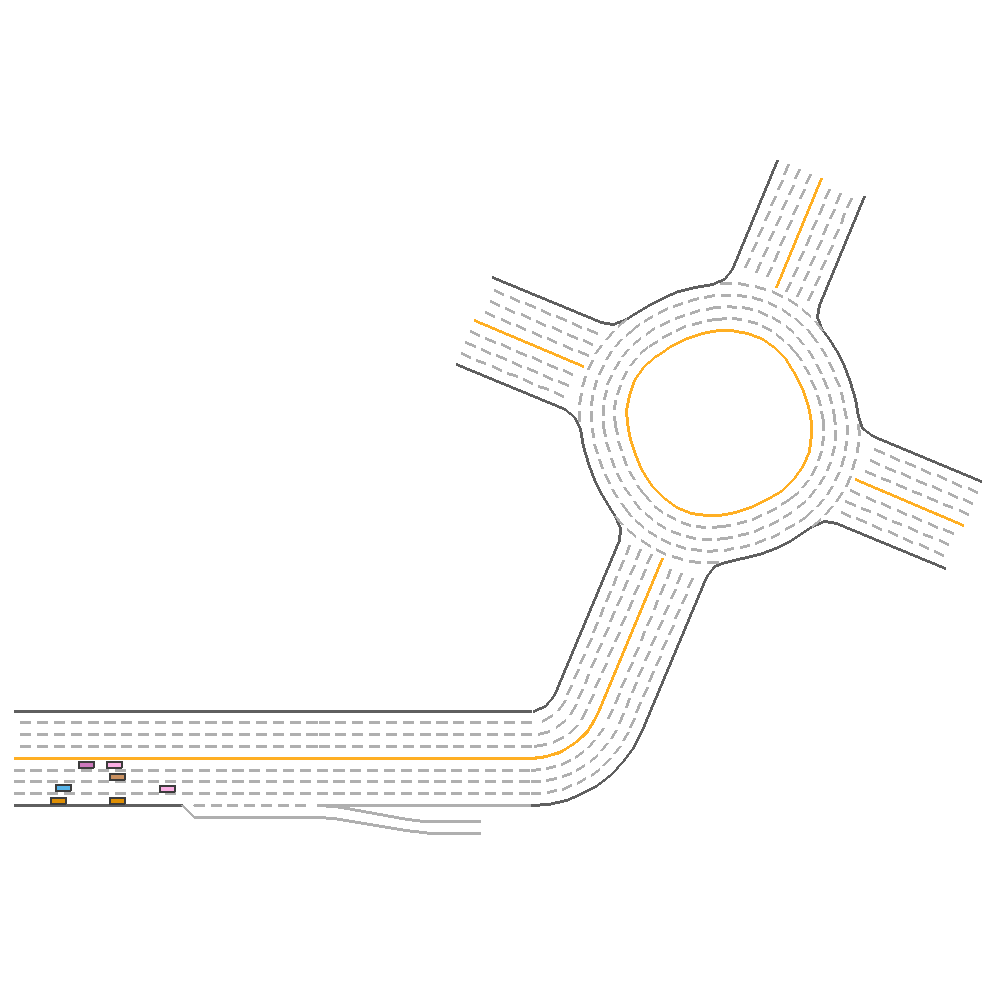

TD3 agent achieves 623.065054845365 return in MetaDrive Hard environment.


In [7]:
from core.envs import make_envs
import gym
from vis import TD3MARLPolicy, evaluate_MARL, animate
import pygame
import random
import numpy as np
env_name = "MetaDrive-MARL-v0"
policy = TD3MARLPolicy(
    env_name,  # In order to get the observation shape
    num_envs=1, 
    log_dir="MetaDrive-td3combine-expt_with_safe-alt-env/MetaDrive-Alt-Next-v1/td3",
    suffix="final"
)

random.seed(1)
np.random.seed(1)
map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
env = gym.make(env_name, config={"environment_num":1, "start_seed":70,"map_config":map_config})
env.seed(0)
env._reset_global_seed(0)
print(env.config.vehicle_config)

# Render the learned behavior
# NOTE: The learned agent is marked by green color.
eval_reward, eval_info = evaluate_MARL(
    policy=policy, 
    num_episodes=1, 
    existing_env=env,
    render="topdown",  # Visualize the behaviors in top-down view
    verbose=True
)

frames = [pygame.surfarray.array3d(f).swapaxes(0, 1) for f in eval_info["frames"]]
import tempfile

import IPython
import PIL
import gym
import numpy as np
from IPython.display import clear_output

def animate(img_array):
    """A function that can generate GIF file and show in Notebook."""
    path = tempfile.mkstemp(suffix=".gif")[1]
    images = [PIL.Image.fromarray(frame) for frame in img_array]
    images[0].save(
        path,
        save_all=True,
        append_images=images[1:],
        duration=0.5,
        loop=0
    )
    with open(path, "rb") as f:
        IPython.display.display(
            IPython.display.Image(data=f.read(), format='png'))

animate(frames)

print("TD3 agent achieves {} return in MetaDrive Hard environment.".format(eval_reward))

In [4]:
from core.envs import make_envs
import gym
from vis import TD3MARLPolicy, evaluate_MARL, animate
import pygame
import random
import numpy as np
env_name = "MetaDrive-MARL-v0"
policy_general = TD3MARLPolicy(
    env_name,  # In order to get the observation shape
    num_envs=1, 
    log_dir="MetaDrive-Expt-Safe-Combine/td3",
    suffix="final"
)
gen=0
for i in range(10):
    map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
    env = gym.make(env_name, config={"environment_num":1, "start_seed":random.randint(1,100),"map_config":map_config})
    env.seed(0)
    env._reset_global_seed(0)

    # Render the learned behavior
    # NOTE: The learned agent is marked by green color.
    eval_reward, eval_info = evaluate_MARL(
        policy=policy_general, 
        num_episodes=1, 
        existing_env=env,
        render="topdown",  # Visualize the behaviors in top-down view
        verbose=True
    )
    gen+=eval_reward
#     env.reset()
#     eval_reward, eval_info = evaluate_MARL(
#         policy=policy_chain, 
#         num_episodes=1, 
#         existing_env=env,
#         render="topdown",  # Visualize the behaviors in top-down view
#         verbose=True
#     )
#     env.reset()
#     chain+=eval_reward
#     eval_reward, eval_info = evaluate_MARL(
#         policy=policy_chain_safe, 
#         num_episodes=1, 
#         existing_env=env,
#         render="topdown",  # Visualize the behaviors in top-down view
#         verbose=True
#     )
#     safe+=eval_reward
#     env.reset()
    env.close()
print(gen)

:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 2.527
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 15.289
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 34.532
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 61.599
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 93.760
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 129.465
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 166.691
Evaluating 1/1 episodes. We are in 401/1000 steps. Current episode reward: 202.893
Evaluating 1/1 episodes. We are in 451/1000 steps. Current episode reward: 239.147
Evaluating 1/1 episodes. We are in 501/1000 steps. Current episode reward: 276.164
Evaluating 1/1 episodes. We are in 551/1000 steps. Current episode reward: 311.834
Evaluating 1/1 

:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 0.358
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 7.790
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 23.512
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 47.122
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 73.388
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 107.103
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 143.680
Evaluating 1/1 episodes. We are in 401/1000 steps. Current episode reward: 182.736
Evaluating 1/1 episodes. We are in 451/1000 steps. Current episode reward: 221.628
Evaluating 1/1 episodes. We are in 501/1000 steps. Current episode reward: 261.541
Evaluating 1/1 episodes. We are in 551/1000 steps. Current episode reward: 300.798
Evaluating 1/1 e

:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 3.826
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 12.931
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 32.287
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 62.477
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 98.809
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 138.310
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 186.209
Evaluating 1/1 episodes. We are in 401/1000 steps. Current episode reward: 238.195
Evaluating 1/1 episodes. We are in 451/1000 steps. Current episode reward: 291.303
Evaluating 1/1 episodes. We are in 501/1000 steps. Current episode reward: 345.034
Evaluating 1/1 episodes. We are in 551/1000 steps. Current episode reward: 393.249
Evaluating 1/1 

:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 2.175
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 9.927
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 22.671
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 40.632
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 58.709
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 86.784
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 116.803
Evaluating 1/1 episodes. We are in 401/1000 steps. Current episode reward: 148.167
Evaluating 1/1 episodes. We are in 451/1000 steps. Current episode reward: 182.056
Evaluating 1/1 episodes. We are in 501/1000 steps. Current episode reward: 214.988
Evaluating 1/1 episodes. We are in 551/1000 steps. Current episode reward: 249.238
Evaluating 1/1 ep

:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: -0.606
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 9.288
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 23.493
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 44.675
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 69.616
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 101.408
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 140.636
Evaluating 1/1 episodes. We are in 401/1000 steps. Current episode reward: 184.801
Evaluating 1/1 episodes. We are in 451/1000 steps. Current episode reward: 228.508
Evaluating 1/1 episodes. We are in 501/1000 steps. Current episode reward: 274.146
Evaluating 1/1 episodes. We are in 551/1000 steps. Current episode reward: 318.330
Evaluating 1/1 

:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: -0.051
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 10.430
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 25.036
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 49.932
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 79.486
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 115.347
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 154.130
Evaluating 1/1 episodes. We are in 401/1000 steps. Current episode reward: 194.335
Evaluating 1/1 episodes. We are in 451/1000 steps. Current episode reward: 233.666
Evaluating 1/1 episodes. We are in 501/1000 steps. Current episode reward: 271.363
Evaluating 1/1 episodes. We are in 551/1000 steps. Current episode reward: 310.094
Evaluating 1/1

:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: -0.087
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 10.385
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 24.596
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 38.570
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 65.259
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 96.635
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 131.427
Evaluating 1/1 episodes. We are in 401/1000 steps. Current episode reward: 171.007
Evaluating 1/1 episodes. We are in 451/1000 steps. Current episode reward: 210.703
Evaluating 1/1 episodes. We are in 501/1000 steps. Current episode reward: 250.691
Evaluating 1/1 episodes. We are in 551/1000 steps. Current episode reward: 290.872
Evaluating 1/1 

:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 1.501
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 11.256
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 28.065
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 54.328
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 86.167
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 116.670
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 146.062
Evaluating 1/1 episodes. We are in 401/1000 steps. Current episode reward: 182.427
Evaluating 1/1 episodes. We are in 451/1000 steps. Current episode reward: 226.662
Evaluating 1/1 episodes. We are in 501/1000 steps. Current episode reward: 273.864
Evaluating 1/1 episodes. We are in 551/1000 steps. Current episode reward: 321.678
Evaluating 1/1 

:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 3.184
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 12.820
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 27.319
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 47.746
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 73.230
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 104.607
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 138.504
Evaluating 1/1 episodes. We are in 401/1000 steps. Current episode reward: 174.463
Evaluating 1/1 episodes. We are in 451/1000 steps. Current episode reward: 210.837
Evaluating 1/1 episodes. We are in 501/1000 steps. Current episode reward: 247.221
Evaluating 1/1 episodes. We are in 551/1000 steps. Current episode reward: 283.658
Evaluating 1/1 

:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: -1.344
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 9.874
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 27.606
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 50.994
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 83.346
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 125.243
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 170.799
Evaluating 1/1 episodes. We are in 401/1000 steps. Current episode reward: 224.194
Evaluating 1/1 episodes. We are in 451/1000 steps. Current episode reward: 280.172
Evaluating 1/1 episodes. We are in 501/1000 steps. Current episode reward: 332.777
Evaluating 1/1 episodes. We are in 551/1000 steps. Current episode reward: 384.525
Evaluating 1/1 

In [11]:
path = "./marl_with_safe_combine.gif"
images = [PIL.Image.fromarray(frame) for frame in frames]
images[0].save(
    path,
    save_all=True,
    append_images=images[1:],
    duration=20.0,
    loop=0
)

In [12]:
# for i in range(10):
#     map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
#     env = gym.make(env_name, config={"environment_num":1, "start_seed":random.randint(1,100),"map_config":map_config})
#     env.seed(0)
#     env._reset_global_seed(0)

#     # Render the learned behavior
#     # NOTE: The learned agent is marked by green color.
#     eval_reward, eval_info = evaluate_MARL(
#         policy=policy_general, 
#         num_episodes=1, 
#         existing_env=env,
#         render="topdown",  # Visualize the behaviors in top-down view
#         verbose=True
#     )
#     gen+=eval_reward
#     env.reset()
#     eval_reward, eval_info = evaluate_MARL(
#         policy=policy_chain, 
#         num_episodes=1, 
#         existing_env=env,
#         render="topdown",  # Visualize the behaviors in top-down view
#         verbose=True
#     )
#     env.reset()
#     chain+=eval_reward
#     eval_reward, eval_info = evaluate_MARL(
#         policy=policy_chain_safe, 
#         num_episodes=1, 
#         existing_env=env,
#         render="topdown",  # Visualize the behaviors in top-down view
#         verbose=True
#     )
#     safe+=eval_reward
#     env.reset()
#     env.close()
# print(gen,chain,safe)

/Users/tanmay/opt/anaconda3/envs/cs269/lib/python3.7/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


/Users/tanmay/Desktop/Fall 2022/RL/assignment-2022fall/assignment3-project/core
/Users/tanmay/Desktop/Fall 2022/RL/assignment-2022fall/assignment3-project/core
pygame 2.1.2 (SDL 2.0.18, Python 3.7.13)
Hello from the pygame community. https://www.pygame.org/contribute.html


Successfully registered the following environments: ['MetaDrive-validation-v0', 'MetaDrive-10env-v0', 'MetaDrive-100envs-v0', 'MetaDrive-1000envs-v0', 'SafeMetaDrive-validation-v0', 'SafeMetaDrive-10env-v0', 'SafeMetaDrive-100envs-v0', 'SafeMetaDrive-1000envs-v0', 'MARLTollgate-v0', 'MARLBottleneck-v0', 'MARLRoundabout-v0', 'MARLIntersection-v0', 'MARLParkingLot-v0', 'MARLMetaDrive-v0'].
Successfully registered MetaDrive environments:  ['MetaDrive-Tut-Easy-v0', 'MetaDrive-Tut-Hard-v0', 'MetaDrive-Tut-1Env-v0', 'MetaDrive-Tut-5Env-v0', 'MetaDrive-Tut-10Env-v0', 'MetaDrive-Tut-20Env-v0', 'MetaDrive-Tut-50Env-v0', 'MetaDrive-Tut-100Env-v0', 'MetaDrive-Tut-Test-v0', 'MetaDrive-MARL-v0', 'MetaDrive-MARL-v1', 'MetaDrive-MARL-v2', 'MetaDrive-MARL-v3']
{'increment_steering': False, 'vehicle_model': 'static_default', 'show_navi_mark': True, 'extra_action_dim': 0, 'enable_reverse': False, 'random_navi_mark_color': False, 'show_dest_mark': False, 'show_line_to_dest': False, 'use_special_color': F

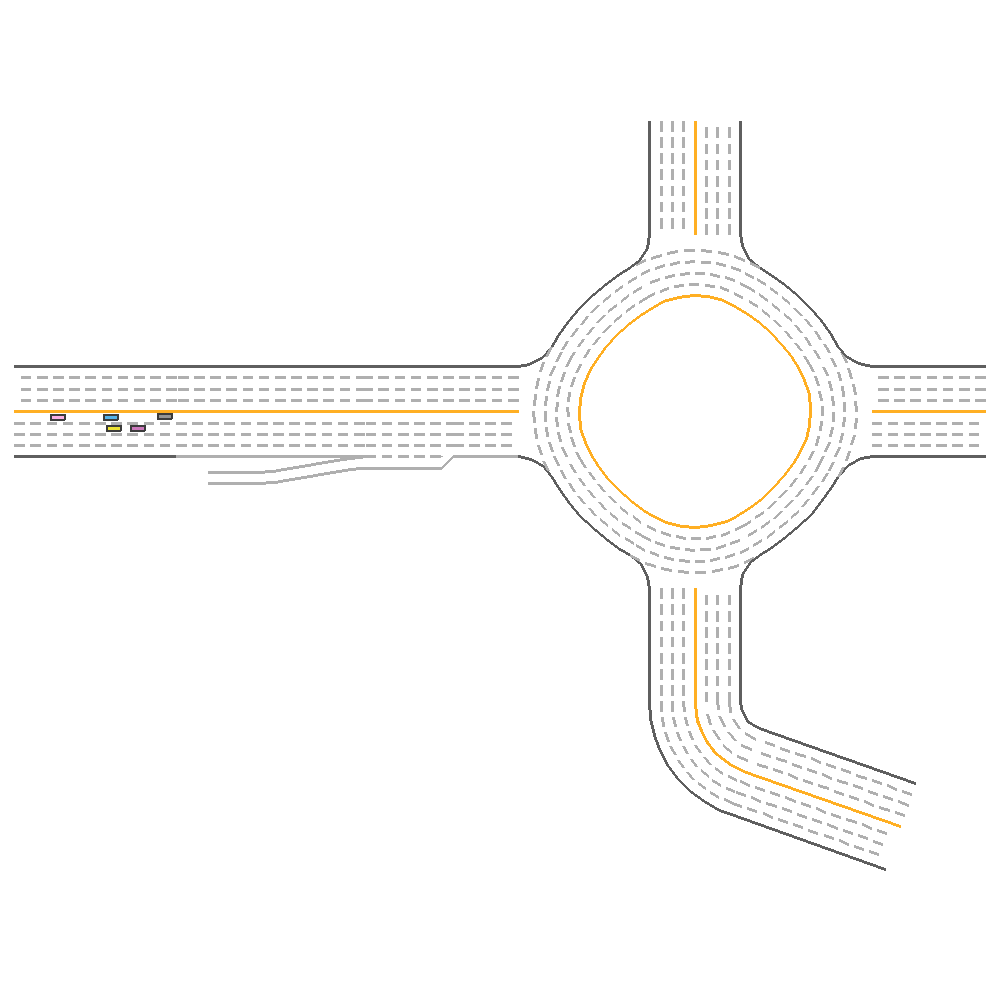

TD3 agent achieves 657.8690135035049 return in MetaDrive Hard environment.


In [1]:
from core.envs import make_envs
import gym
from vis import TD3MARLPolicy, evaluate_MARL, animate
import pygame
import random
import numpy as np
env_name = "MetaDrive-MARL-v1"
policy = TD3MARLPolicy(
    env_name,  # In order to get the observation shape
    num_envs=1, 
    log_dir="MetaDrive-Expt-Safe-Combine/td3",
    suffix="final"
)

random.seed(1)
np.random.seed(1)
map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
env = gym.make(env_name, config={"environment_num":1, "start_seed":120,"map_config":map_config})
env.seed(0)
env._reset_global_seed(0)
print(env.config.vehicle_config)

# Render the learned behavior
# NOTE: The learned agent is marked by green color.
eval_reward, eval_info = evaluate_MARL(
    policy=policy, 
    num_episodes=1, 
    existing_env=env,
    render="topdown",  # Visualize the behaviors in top-down view
    verbose=True
)

frames = [pygame.surfarray.array3d(f).swapaxes(0, 1) for f in eval_info["frames"]]
import tempfile

import IPython
import PIL
import gym
import numpy as np
from IPython.display import clear_output

def animate(img_array):
    """A function that can generate GIF file and show in Notebook."""
    path = tempfile.mkstemp(suffix=".gif")[1]
    images = [PIL.Image.fromarray(frame) for frame in img_array]
    images[0].save(
        path,
        save_all=True,
        append_images=images[1:],
        duration=0.5,
        loop=0
    )
    with open(path, "rb") as f:
        IPython.display.display(
            IPython.display.Image(data=f.read(), format='png'))

animate(frames)

print("TD3 agent achieves {} return in MetaDrive Hard environment.".format(eval_reward))

In [2]:
path = "./marl_with_5_agents.gif"
images = [PIL.Image.fromarray(frame) for frame in frames]
images[0].save(
    path,
    save_all=True,
    append_images=images[1:],
    duration=20.0,
    loop=0
)

In [3]:
from core.envs import make_envs
import gym
from vis import TD3MARLPolicy, evaluate_MARL, animate
import pygame
import random
import numpy as np
env_name = "MetaDrive-MARL-v2"
policy = TD3MARLPolicy(
    env_name,  # In order to get the observation shape
    num_envs=1, 
    log_dir="MetaDrive-Expt-Safe-Combine/td3",
    suffix="final"
)

random.seed(1)
np.random.seed(1)
map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
env = gym.make(env_name, config={"environment_num":1, "start_seed":120,"map_config":map_config})
env.seed(0)
env._reset_global_seed(0)
print(env.config.vehicle_config)

# Render the learned behavior
# NOTE: The learned agent is marked by green color.
eval_reward, eval_info = evaluate_MARL(
    policy=policy, 
    num_episodes=1, 
    existing_env=env,
    render="topdown",  # Visualize the behaviors in top-down view
    verbose=True
)

frames = [pygame.surfarray.array3d(f).swapaxes(0, 1) for f in eval_info["frames"]]
import tempfile

import IPython
import PIL
import gym
import numpy as np
from IPython.display import clear_output

# def animate(img_array):
#     """A function that can generate GIF file and show in Notebook."""
#     path = tempfile.mkstemp(suffix=".gif")[1]
#     images = [PIL.Image.fromarray(frame) for frame in img_array]
#     images[0].save(
#         path,
#         save_all=True,
#         append_images=images[1:],
#         duration=0.5,
#         loop=0
#     )
#     with open(path, "rb") as f:
#         IPython.display.display(
#             IPython.display.Image(data=f.read(), format='png'))

# animate(frames)

print("TD3 agent achieves {} return in MetaDrive Hard environment.".format(eval_reward))

Cannot re-register id: MetaDrive-Tut-Easy-v0
{'increment_steering': False, 'vehicle_model': 'static_default', 'show_navi_mark': True, 'extra_action_dim': 0, 'enable_reverse': False, 'random_navi_mark_color': False, 'show_dest_mark': False, 'show_line_to_dest': False, 'use_special_color': False, 'image_source': 'rgb_camera', 'navigation_module': None, 'need_navigation': True, 'spawn_lane_index': ('>', '>>', 0), 'spawn_longitude': 5.0, 'spawn_lateral': 0.0, 'destination': None, 'overtake_stat': False, 'action_check': False, 'random_color': True, 'random_agent_model': False, 'lidar': {'num_lasers': 240, 'distance': 50, 'num_others': 0, 'gaussian_noise': 0.0, 'dropout_prob': 0.0, 'add_others_navi': False}, 'side_detector': {'num_lasers': 0, 'distance': 50, 'gaussian_noise': 0.0, 'dropout_prob': 0.0}, 'lane_line_detector': {'num_lasers': 0, 'distance': 20, 'gaussian_noise': 0.0, 'dropout_prob': 0.0}, 'show_lidar': False, 'mini_map': (84, 84, 250), 'rgb_camera': (84, 84), 'depth_camera': (84

:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 1.402
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 2.109
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 10.124
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 20.224
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 35.014
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 51.280
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 66.658
Evaluating 1/1 episodes. We are in 401/1000 steps. Current episode reward: 87.268
Evaluating 1/1 episodes. We are in 451/1000 steps. Current episode reward: 109.162
Evaluating 1/1 episodes. We are in 501/1000 steps. Current episode reward: 127.318
Evaluating 1/1 episodes. We are in 551/1000 steps. Current episode reward: 141.127
Evaluating 1/1 epis

In [4]:
path = "./marl_with_15_agents.gif"
images = [PIL.Image.fromarray(frame) for frame in frames]
images[0].save(
    path,
    save_all=True,
    append_images=images[1:],
    duration=20.0,
    loop=0
)

In [5]:
from core.envs import make_envs
import gym
from vis import TD3MARLPolicy, evaluate_MARL, animate
import pygame
import random
import numpy as np
env_name = "MetaDrive-MARL-v2"
policy = TD3MARLPolicy(
    env_name,  # In order to get the observation shape
    num_envs=1, 
    log_dir="MetaDrive-Expt-Safe-Combine/td3",
    suffix="final"
)

random.seed(1)
np.random.seed(1)
map_config = {'type': 'block_num', 'config': 3, 'lane_width': 3.5, 'lane_num': 4, 'exit_length': 50}
env = gym.make(env_name, config={"environment_num":1, "start_seed":120,"map_config":map_config})
env.seed(0)
env._reset_global_seed(0)
print(env.config.vehicle_config)

# Render the learned behavior
# NOTE: The learned agent is marked by green color.
eval_reward, eval_info = evaluate_MARL(
    policy=policy, 
    num_episodes=1, 
    existing_env=env,
    render="topdown",  # Visualize the behaviors in top-down view
    verbose=True
)

frames = [pygame.surfarray.array3d(f).swapaxes(0, 1) for f in eval_info["frames"]]
import tempfile

import IPython
import PIL
import gym
import numpy as np
from IPython.display import clear_output

# def animate(img_array):
#     """A function that can generate GIF file and show in Notebook."""
#     path = tempfile.mkstemp(suffix=".gif")[1]
#     images = [PIL.Image.fromarray(frame) for frame in img_array]
#     images[0].save(
#         path,
#         save_all=True,
#         append_images=images[1:],
#         duration=0.5,
#         loop=0
#     )
#     with open(path, "rb") as f:
#         IPython.display.display(
#             IPython.display.Image(data=f.read(), format='png'))

# animate(frames)

print("TD3 agent achieves {} return in MetaDrive Hard environment.".format(eval_reward))

Cannot re-register id: MetaDrive-Tut-Easy-v0
{'increment_steering': False, 'vehicle_model': 'static_default', 'show_navi_mark': True, 'extra_action_dim': 0, 'enable_reverse': False, 'random_navi_mark_color': False, 'show_dest_mark': False, 'show_line_to_dest': False, 'use_special_color': False, 'image_source': 'rgb_camera', 'navigation_module': None, 'need_navigation': True, 'spawn_lane_index': ('>', '>>', 0), 'spawn_longitude': 5.0, 'spawn_lateral': 0.0, 'destination': None, 'overtake_stat': False, 'action_check': False, 'random_color': True, 'random_agent_model': False, 'lidar': {'num_lasers': 240, 'distance': 50, 'num_others': 0, 'gaussian_noise': 0.0, 'dropout_prob': 0.0, 'add_others_navi': False}, 'side_detector': {'num_lasers': 0, 'distance': 50, 'gaussian_noise': 0.0, 'dropout_prob': 0.0}, 'lane_line_detector': {'num_lasers': 0, 'distance': 20, 'gaussian_noise': 0.0, 'dropout_prob': 0.0}, 'show_lidar': False, 'mini_map': (84, 84, 250), 'rgb_camera': (84, 84), 'depth_camera': (84

:task(warning): Creating implicit AsyncTaskChain default for AsyncTaskManager TaskManager


Evaluating 1/1 episodes. We are in 1/1000 steps. Current episode reward: 0.000
Evaluating 1/1 episodes. We are in 51/1000 steps. Current episode reward: 1.091
Evaluating 1/1 episodes. We are in 101/1000 steps. Current episode reward: 1.460
Evaluating 1/1 episodes. We are in 151/1000 steps. Current episode reward: 13.581
Evaluating 1/1 episodes. We are in 201/1000 steps. Current episode reward: 26.523
Evaluating 1/1 episodes. We are in 251/1000 steps. Current episode reward: 43.119
Evaluating 1/1 episodes. We are in 301/1000 steps. Current episode reward: 62.162
Evaluating 1/1 episodes. We are in 351/1000 steps. Current episode reward: 81.775
Evaluating 1/1 episodes. We are in 401/1000 steps. Current episode reward: 97.990
Evaluating 1/1 episodes. We are in 451/1000 steps. Current episode reward: 119.729
Evaluating 1/1 episodes. We are in 501/1000 steps. Current episode reward: 137.874
Evaluating 1/1 episodes. We are in 551/1000 steps. Current episode reward: 151.042
Evaluating 1/1 epis

In [6]:
path = "./marl_with_40_agents.gif"
images = [PIL.Image.fromarray(frame) for frame in frames]
images[0].save(
    path,
    save_all=True,
    append_images=images[1:],
    duration=20.0,
    loop=0
)